In [1]:
import tensorflow as tf
from autodidatta.datasets.oai import load_dataset
import matplotlib.pyplot as plt

In [2]:
pretrain_ds = load_dataset(
    dataset_dir='gs://oai-challenge-dataset/data/tfrecords',
    batch_size=128,
    image_size=288,
    buffer_size=5000,
    training_mode='pretrain',
    fraction_data=1.0,
    multi_class=False,
    add_background=False,
    normalize=True
)

2021-09-04 23:19:51.723121: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  SSE3 SSE4.1 SSE4.2 AVX AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
D0904 23:19:55.074117749  227135 ev_posix.cc:173]            Using polling engine: epollex
D0904 23:19:55.074206129  227135 lb_policy_registry.cc:42]   registering LB policy factory for "grpclb"
D0904 23:19:55.074211936  227135 lb_policy_registry.cc:42]   registering LB policy factory for "priority_experimental"
D0904 23:19:55.074215206  227135 lb_policy_registry.cc:42]   registering LB policy factory for "weighted_target_experimental"
D0904 23:19:55.074217760  227135 lb_policy_registry.cc:42]   registering LB policy factory for "pick_first"
D0904 23:19:55.074220756  227135 lb_policy_registry.cc:42]   registering LB pol

2021-09-04 23:19:56.824405: I tensorflow/compiler/mlir/mlir_graph_optimization_pass.cc:179] None of the MLIR Optimization Passes are enabled (registered 2)


(128, 288, 288, 2)


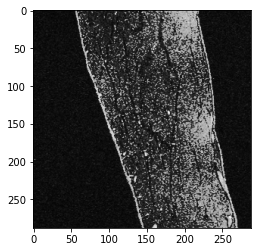

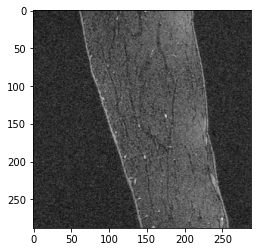

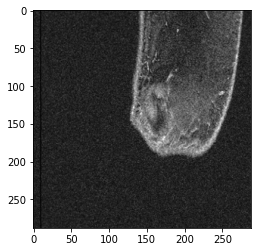

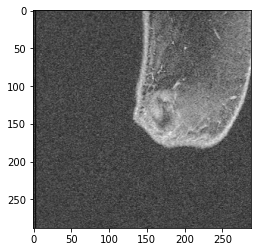

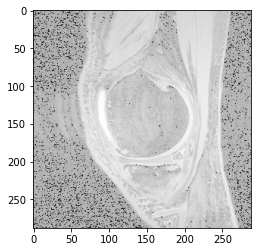

...

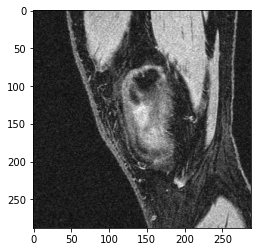

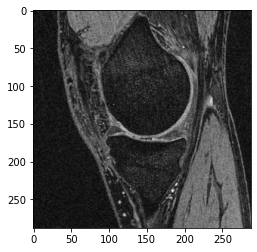

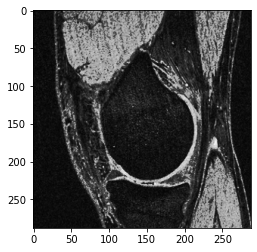

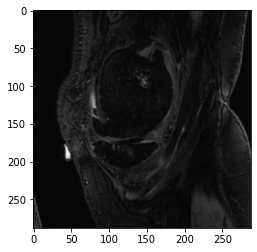

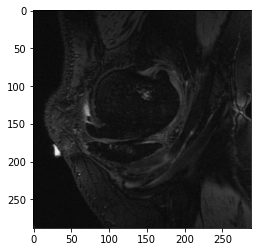

In [3]:
for step, image in enumerate(pretrain_ds):
    print(image.shape)
    for i in range(image.shape[0]):
        plt.imshow(image[i,:,:,0], cmap='gray')
        plt.show()
        plt.imshow(image[i,:,:,1], cmap='gray')
        plt.show()
    if step == 0:
        break

In [4]:
train_ds, val_ds = load_dataset(
            batch_size=64,
            image_size=288,
            dataset_dir='gs://oai-challenge-dataset/tfrecords',
            training_mode='finetune',
            fraction_data=1.0,
            multi_class=False,
            add_background=False,
            normalize=False,
            buffer_size=500)

TypeError: load_dataset() missing 1 required positional argument: 'image_size'

In [ ]:
for step, (image, seg) in enumerate(train_ds):
#     image1, image2 = get_preprocess_fn(image[0,...], True, 288)
    sample_img = image[0,:,:,:]
    sample_seg = seg[0,:,:,:]
    plt.imshow(image[0,:,:,0], cmap='gray')
    plt.show()
#     plt.imshow(image1[0,:,:,0], cmap='gray')
#     plt.imshow(image2[0,:,:,0], cmap='gray')
    plt.imshow(seg[0,:,:,0], cmap='gray')
    plt.show()
    if step == 0:
        break

In [ ]:
# sample_img = normalize_image(sample_img)
sample_img = sample_img / tf.math.reduce_max(sample_img)
sample_img = tf.clip_by_value(sample_img, 0., 1.)
print(sample_img.shape, sample_seg.shape)

In [ ]:
plt.hist(sample_img[...,0])
plt.show()

In [ ]:
image_bright = tf.clip_by_value(tf.image.adjust_brightness(sample_img, 0.5), 0., 1.)
image_contrast = tf.clip_by_value(tf.image.adjust_contrast(sample_img, 2.0), 0., 1.)
image_gamma = tf.clip_by_value(tf.image.adjust_gamma(sample_img, 0.2), 0., 1.)
image_noise = tf.clip_by_value(random_gaussian_noise(sample_img, 0.5), 0., 1.)
image_blur = gaussian_blur(sample_img, 28.8, 2.0, padding='SAME')
image_crop = random_crop_with_resize(sample_img, [288,288], (0.2, 0.5))
image_flip = tf.image.flip_left_right(sample_img)

In [ ]:
plt.figure(figsize=(8,4))
plt.subplot(2, 4, 1)
plt.imshow(sample_img[...,0], cmap='gray')
plt.title('Original')
plt.subplot(2, 4, 2)
plt.imshow(image_bright[...,0], cmap='gray')
plt.title('Brightness')
plt.subplot(2, 4, 3)
plt.imshow(image_contrast[...,0], cmap='gray')
plt.title('Contrast')
plt.subplot(2, 4, 4)
plt.imshow(image_gamma[...,0], cmap='gray')
plt.title('Gamma')
plt.subplot(2, 4, 5)
plt.imshow(image_noise[...,0], cmap='gray')
plt.title('Gaussian Noise')
plt.subplot(2, 4, 6)
plt.imshow(image_blur[...,0], cmap='gray')
plt.title('Gaussian Blur')
plt.subplot(2, 4, 7)
plt.imshow(image_crop[...,0],cmap='gray')
plt.title('Crop and Resize')
plt.subplot(2, 4, 8)
plt.imshow(image_flip[...,0],cmap='gray')
plt.title('Flip')
plt.tight_layout()
plt.savefig('augmentation_examples.png')